# Imports, common functions

In [2]:
import seaborn as sns 
import matplotlib.pyplot as plt 
import numpy as np
from tqdm.notebook import trange, tqdm
import pandas as pd

import torch 
import torch.nn as nn 
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader

import time

from sklearn.preprocessing import StandardScaler

def moveTo(obj, device): 
    """ 
    obj: the python object to move to a device, or to move its
    ➥ contents to a device
    device: the compute device to move objects to 
    """
    if isinstance(obj, list): 
        return [moveTo(x, device) for x in obj] 
    elif isinstance(obj, tuple): 
        return tuple(moveTo(list(obj), device)) 
    elif isinstance(obj, set): 
        return set(moveTo(list(obj), device)) 
    elif isinstance(obj, dict): 
        to_ret = dict() 
        for key, value in obj.items(): 
            to_ret[moveTo(key, device)] = moveTo(value, device) 
        return to_ret 
    elif hasattr(obj, "to"): 
        return obj.to(device) 
    else: 
        return obj

def train_simple_network(model, loss_func, training_loader, epochs=20, device="cpu"): 
    optimizer = torch.optim.SGD(model.parameters(), lr=0.001)

    model.to(device)

    for epoch in trange(epochs, desc="Epoch"):
        model = model.train()
        running_loss = 0.0

        for inputs, labels in tqdm(training_loader, desc="Batch", leave=False):
            inputs = moveTo(inputs, device)
            labels = moveTo(labels, device)

            optimizer.zero_grad()

            y_hat = model(inputs)

            loss = loss_func(y_hat, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()  

def visualize2DSoftmax(X, y, model, title=None): 
    x_min = np.min(X[:,0])-0.5 
    x_max = np.max(X[:,0])+0.5 
    y_min = np.min(X[:,1])-0.5
    y_max = np.max(X[:,1])+0.5 
    xv, yv = np.meshgrid(np.linspace(x_min, x_max, num=20), np.linspace(y_min, y_max, num=20), indexing='ij') 
    xy_v = np.hstack((xv.reshape(-1,1), yv.reshape(-1,1))) 
    with torch.no_grad():
        logits = model(torch.tensor(xy_v, dtype=torch.float32)) 
        y_hat = F.softmax(logits, dim=1).numpy()

    cs = plt.contourf(xv, yv, y_hat[:,0].reshape(20,20), levels=np.linspace(0,1,num=30), cmap=plt.cm.RdYlBu) 
    ax = plt.gca() 
    sns.scatterplot(x=X[:,0], y=X[:,1], hue=y, style=y, ax=ax) 
    if title is not None: 
        ax.set_title(title)

class Simple1DRegressionDataset(Dataset): 
    def __init__(self, X, y):
        super(Simple1DRegressionDataset, self).__init__() 
        self.X = X.reshape(-1,1) 
        self.y = y.reshape(-1,1) 
    def __getitem__(self, index):
        return torch.tensor(self.X[index,:], dtype=torch.float32), torch.tensor(self.y[index], dtype=torch.float32)

    def __len__(self): 
        return self.X.shape[0]    

def run_epoch(model, optimizer, data_loader, loss_func, device, results, score_funcs, prefix="", desc=None):
    """
    model -- the PyTorch model / "Module" to run for one epoch
    optimizer -- the object that will update the weights of the network
    data_loader -- DataLoader object that returns tuples of (input, label) pairs. 
    loss_func -- the loss function that takes in two arguments, the model outputs and the labels, and returns a score
    device -- the compute lodation to perform training
    score_funcs -- a dictionary of scoring functions to use to evalue the performance of the model
    prefix -- a string to pre-fix to any scores placed into the _results_ dictionary. 
    desc -- a description to use for the progress bar.     
    """
    running_loss = []
    y_true = []
    y_pred = []
    start = time.time()
    for inputs, labels in tqdm(data_loader, desc=desc, leave=False):
        #Move the batch to the device we are using. 
        inputs = moveTo(inputs, device)
        labels = moveTo(labels, device)

        y_hat = model(inputs) #this just computed f_Θ(x(i))
        # Compute loss.
        loss = loss_func(y_hat, labels)

        if model.training:
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()

        #Now we are just grabbing some information we would like to have
        running_loss.append(loss.item())

        if len(score_funcs) > 0 and isinstance(labels, torch.Tensor):
            #moving labels & predictions back to CPU for computing / storing predictions
            labels = labels.detach().cpu().numpy()
            y_hat = y_hat.detach().cpu().numpy()
            #add to predictions so far
            y_true.extend(labels.tolist())
            y_pred.extend(y_hat.tolist())
    #end training epoch
    end = time.time()
    
    y_pred = np.asarray(y_pred)
    if len(y_pred.shape) == 2 and y_pred.shape[1] > 1: #We have a classification problem, convert to labels
        y_pred = np.argmax(y_pred, axis=1)
    #Else, we assume we are working on a regression problem
    
    results[prefix + " loss"].append( np.mean(running_loss) )
    if len(score_funcs) > 0 :
      for name, score_func in score_funcs.items():
          try:
              results[prefix + " " + name].append( score_func(y_true, y_pred) )
          except:
              results[prefix + " " + name].append(float("NaN"))
    return end-start #time spent on epoch                 

# Excercise 1
The input range of data can have a large impact on a neural network. This applies to inputs and outputs, as for regression problems. Try applying scikit-learn’s `StandardScaler` to the targets y of the toy regression problem at the start of this chapter, and train a new neural network on it. Does changing the scale of the outputs help or hurt the model’s predictions? 

In [ ]:
X = np.linspace(0, 20, num=200)
y = X + np.sin(X)*2 + np.random.normal(size=X.shape)

scaler = StandardScaler()

y_scaled = scaler.fit_transform(y.reshape(-1, 1))

model = nn.Sequential(
  nn.Linear(1, 10),
  nn.Tanh(),
  nn.Linear(10, 1),
)

training_loader = DataLoader(Simple1DRegressionDataset(X, y_scaled), shuffle=True)
loss_func = nn.MSELoss()

train_simple_network(model, loss_func, training_loader, epochs=200)

with torch.no_grad(): 
    Y_pred = model(torch.tensor(X.reshape(-1,1), dtype=torch.float32)).cpu().numpy()

Epoch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

In [ ]:
model_no_scale = nn.Sequential( nn.Linear(1, 10),
  nn.Tanh(),
  nn.Linear(10, 1),
)

training_loader_no_scale = DataLoader(Simple1DRegressionDataset(X, y), shuffle=True)
loss_func_no_scale = nn.MSELoss()

train_simple_network(model_no_scale, loss_func_no_scale, training_loader_no_scale, epochs=200)

with torch.no_grad(): 
    Y_pred_no_scale = model_no_scale(torch.tensor(X.reshape(-1,1), dtype=torch.float32)).cpu().numpy()

Epoch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Batch:   0%|          | 0/200 [00:00<?, ?it/s]

Non-scaled loss:  tensor(7.5798, dtype=torch.float64) , scaled loss:  tensor(3.3525, dtype=torch.float64)


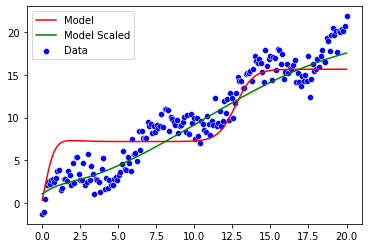

In [ ]:
sns.scatterplot(x=X, y=y, color='blue', label='Data')
sns.lineplot(x=X, y=Y_pred_no_scale.ravel(), color='red', label='Model')
sns.lineplot(x=X, y=scaler.inverse_transform(Y_pred).ravel(), color='green', label='Model Scaled')    

mse_loss = nn.MSELoss()
loss_scaled = mse_loss(torch.tensor(y), torch.tensor(scaler.inverse_transform(Y_pred).ravel()))
loss = mse_loss(torch.tensor(y), torch.tensor(Y_pred_no_scale.ravel()))
print("Non-scaled loss: ", loss, ", scaled loss: ", loss_scaled)

# Excercise 2
The area under the curve (AUC) metric does not follow the standard pattern in scikit-learn, as it requires `y_pred` to be a vector of shape (N) instead a matrix of shape (N,2). Write a wrapper function for AUC that makes it compatible with our `train_simple_network` function. 

In [ ]:
from sklearn.metrics import auc

def auc_wrapped(X, y):
  return auc(X, y[:,0])

(200,)
(200, 1)
(200,)


-2.507250599525684

# Excercise 3
Write a new function `resume_simple_network` that loads a checkpoint_file from disk, restores both the `optimizer` and `model` states, and continues training to a specified total number of epochs. So if the model is saved after 20 epochs, and you specify 30 epochs, it should perform only 10 more epochs of #training. 


In [3]:
# Mostly unchanged functions from the author

import time

def train_simple_network(model, loss_func, train_loader, test_loader=None, score_funcs=None, 
                         epochs=50, epochs_counter_base = 0, device="cpu", checkpoint_file=None, lr=0.001,
                         results = {}):
    """Train simple neural networks
    
    Keyword arguments:
    model -- the PyTorch model / "Module" to train
    loss_func -- the loss function that takes in batch in two arguments, the model outputs and the labels, and returns a score
    train_loader -- PyTorch DataLoader object that returns tuples of (input, label) pairs. 
    test_loader -- Optional PyTorch DataLoader to evaluate on after every epoch
    score_funcs -- A dictionary of scoring functions to use to evalue the performance of the model
    epochs -- the number of training epochs to perform
    device -- the compute lodation to perform training
    
    """
    to_track = ["epoch", "total time", "train loss"]
    if test_loader is not None:
        to_track.append("test loss")
    for eval_score in score_funcs:
        to_track.append("train " + eval_score )
        if test_loader is not None:
            to_track.append("test " + eval_score )
        
    total_train_time = 0 #How long have we spent in the training loop? 
    
    if not bool(results):
      #Initialize every item with an empty list
      for item in to_track:
        results[item] = []
        
    #SGD is Stochastic Gradient Decent.
    optimizer = torch.optim.SGD(model.parameters(), lr=0.001)
    #Place the model on the correct compute resource (CPU or GPU)
    model.to(device)
    for epoch in trange(epochs, desc="Epoch"):
        model = model.train()#Put our model in training mode
        
        total_train_time += run_epoch(model, optimizer, train_loader, loss_func, device, results, score_funcs, prefix="train", desc="Training")

        results["total time"].append( total_train_time )
        results["epoch"].append( epoch + epochs_counter_base )
        
        if test_loader is not None:
            model = model.eval()
            with torch.no_grad():
                run_epoch(model, optimizer, test_loader, loss_func, device, results, score_funcs, prefix="test", desc="Testing")
                    
    if checkpoint_file is not None:
        torch.save({
            'epoch': epoch + epochs_counter_base,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'results' : results
            }, checkpoint_file)

    return pd.DataFrame.from_dict(results)

In [12]:
def resume_simple_network(checkpoint_file, loss_func, train_loader,
                          test_loader=None, score_funcs=None, 
                          epochs=50, device="cpu", lr=0.001):
  model = nn.Sequential( 
    nn.Linear(2, 30), 
    nn.Tanh(), 
    nn.Linear(30, 30), 
    nn.Tanh(), 
    nn.Linear(30, 2),
  ) 
  restored_state = torch.load(checkpoint_file)

  model.load_state_dict(restored_state['model_state_dict'])
  optimizer = torch.optim.SGD(model.parameters(), lr=lr)
  optimizer.load_state_dict(restored_state['optimizer_state_dict'])
  epochs_trained = int(restored_state['epoch']) + 1 # epochs counter is 0-based
  print('Trained epochs:', epochs_trained) 
  epochs_remaining = epochs - epochs_trained
  print('Remaining epochs:', epochs_remaining)
  if epochs_remaining > 0 :
    return train_simple_network(model, loss_func, train_loader, \
                                checkpoint_file=checkpoint_file, \
                                epochs_counter_base = epochs_trained, \
                                test_loader = test_loader, score_funcs = score_funcs, \
                                results = restored_state['results'], \
                                epochs = epochs_remaining, device = device, lr = lr)
  return pd.DataFrame.from_dict(restored_state['results'])

Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

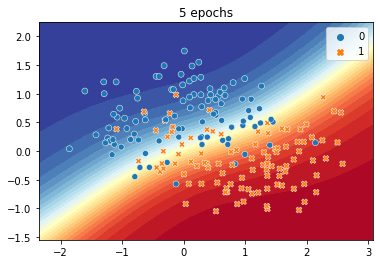

In [ ]:
# Let's test it

from sklearn.metrics import accuracy_score, f1_score
from torch.utils.data import TensorDataset
from sklearn.datasets import make_moons 

score_funcs={'Acc':accuracy_score, 'F1': f1_score}

X_train, y_train = make_moons(n_samples=8000, noise=0.4) 
X_test, y_test = make_moons(n_samples=200, noise=0.4) 
train_dataset = TensorDataset(torch.tensor(X_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.long)) 
test_dataset = TensorDataset(torch.tensor(X_test, dtype=torch.float32), torch.tensor(y_test, dtype=torch.long)) 

training_loader = DataLoader(train_dataset, shuffle=True) 
testing_loader = DataLoader(test_dataset)

loss_func = nn.CrossEntropyLoss()

model = nn.Sequential( 
    nn.Linear(2, 30), 
    nn.Tanh(), 
    nn.Linear(30, 30), 
    nn.Tanh(), 
    nn.Linear(30, 2),
) 

results_initial = train_simple_network(model, loss_func, training_loader, epochs=5, test_loader=testing_loader, checkpoint_file='model.pt', score_funcs=score_funcs)

visualize2DSoftmax(X_test, y_test, model, title="5 epochs")

   epoch  total time  train loss  test loss  train Acc  test Acc  train F1  \
0      0    7.530468    0.423167   0.379458   0.816750     0.840  0.817435   
1      1   12.922664    0.386025   0.376811   0.829125     0.845  0.829700   
2      2   18.800870    0.383118   0.375589   0.830375     0.840  0.830777   
3      3   24.081712    0.380240   0.374714   0.832625     0.845  0.832980   
4      4   29.498518    0.377450   0.371668   0.834000     0.850  0.834455   

    test F1  
0  0.840000  
1  0.842640  
2  0.838384  
3  0.845771  
4  0.848485  


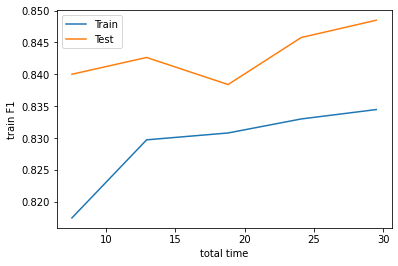

In [ ]:
sns.lineplot(x='total time', y='train F1', data=results_initial, label='Train') 
sns.lineplot(x='total time', y='test F1', data=results_initial, label='Test')
print(results_initial)

In [ ]:
results_resumed = resume_simple_network('model.pt', loss_func, training_loader, \
                                        epochs=10, test_loader=testing_loader, score_funcs=score_funcs)

Trained epochs: 5
Remaining epochs: 5


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

   epoch  total time  train loss  test loss  train Acc  test Acc  train F1  \
0      0    5.676658    0.421781   0.380663   0.813875     0.820  0.812114   
1      1   12.223733    0.380483   0.372493   0.833875     0.835  0.834393   
2      2   15.460214    0.378734   0.369036   0.836375     0.830  0.836803   
3      3   18.718729    0.377121   0.368584   0.836375     0.830  0.836722   
4      4   21.931165    0.374941   0.365258   0.838250     0.830  0.838814   
5      5    3.272431    0.372268   0.361420   0.840500     0.830  0.840739   
6      6    6.477897    0.368385   0.359877   0.842500     0.840  0.842618   
7      7    9.703558    0.363942   0.352884   0.843875     0.840  0.844284   
8      8   16.435352    0.357433   0.347701   0.847125     0.845  0.847373   
9      9   20.739331    0.350216   0.340924   0.850250     0.865  0.850586   

    test F1  
0  0.823529  
1  0.835821  
2  0.830000  
3  0.831683  
4  0.830000  
5  0.830000  
6  0.843137  
7  0.838384  
8  0.844221  
9

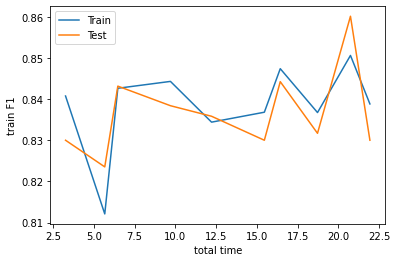

In [ ]:
sns.lineplot(x='total time', y='train F1', data=results_resumed, label='Train') 
sns.lineplot(x='total time', y='test F1', data=results_resumed, label='Test')
print(results_resumed)

# Excercise 4
When performing experiments, we may want to go back and try versions of our model from different epochs, especially if we are trying to determine when some weird behavior started to occur. Modify the `train_simple_network` function to take a new argument `checkpoint_every_x` that saves a version of the model every `x` epochs with different filenames. That way, you can go back and load a specific version without filling your hard drive with a model for every epoch. 

In [6]:
def train_simple_network(model, loss_func, train_loader, test_loader=None, score_funcs=[], 
                         epochs=50, epochs_counter_base = 0, device="cpu", \
                         checkpoint_file=None, checkpoint_every_x = 0, \
                         lr=0.001,
                         results = {}):
    """Train simple neural networks
    
    Keyword arguments:
    model -- the PyTorch model / "Module" to train
    loss_func -- the loss function that takes in batch in two arguments, the model outputs and the labels, and returns a score
    train_loader -- PyTorch DataLoader object that returns tuples of (input, label) pairs. 
    test_loader -- Optional PyTorch DataLoader to evaluate on after every epoch
    score_funcs -- A dictionary of scoring functions to use to evalue the performance of the model
    epochs -- the number of training epochs to perform
    epochs_counter_base -- used if we're resuming existing training to calculate total number of epochs executed
    results -- in case of resuming training, old results value
    device -- the compute lodation to perform training
    checkpoint_every_x -- checkpoint save period. 0 for no checkpoints, 1 for checkpoint on every epoch
    
    """
    to_track = ["epoch", "total time", "train loss"]
    if test_loader is not None:
        to_track.append("test loss")
    if len(score_funcs) > 0 :
      for eval_score in score_funcs:
          to_track.append("train " + eval_score)
          if test_loader is not None:
              to_track.append("test " + eval_score)
        
    total_train_time = 0 #How long have we spent in the training loop? 
    
    if not bool(results):
      #Initialize every item with an empty list
      for item in to_track:
          results[item] = []
        
    #SGD is Stochastic Gradient Decent.
    optimizer = torch.optim.SGD(model.parameters(), lr=0.001)
    #Place the model on the correct compute resource (CPU or GPU)
    model.to(device)
    for epoch in trange(epochs, desc="Epoch"):
        model = model.train()#Put our model in training mode
        
        total_train_time += run_epoch(model, optimizer, train_loader, loss_func, device, results, score_funcs, prefix="train", desc="Training")

        results["total time"].append( total_train_time )
        results["epoch"].append( epoch + epochs_counter_base )
        
        if test_loader is not None:
            model = model.eval()
            with torch.no_grad():
                run_epoch(model, optimizer, test_loader, loss_func, device, results, score_funcs, prefix="test", desc="Testing")
                    
        if checkpoint_file is not None and checkpoint_every_x != 0 and epoch % checkpoint_every_x == 0: 
            torch.save({
                'epoch': epoch + epochs_counter_base,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'results' : results
                }, f'{checkpoint_file}_{epoch}')
    return pd.DataFrame.from_dict(results)

In [ ]:
# Test it

results_checkpoint = train_simple_network(model, loss_func, training_loader, epochs=5, \
                                       test_loader=testing_loader, \
                                       checkpoint_file='model_checkpoints.pt', checkpoint_every_x=2, \
                                       score_funcs=score_funcs)

Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/8000 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

# Excercise 5
The deep part of deep learning refers to the number of layers in a neural network. Try adding more layers (up to 20) to the models we used for the `make_moons` classification problem. How do more layers impact performance? 

Epoch:   0%|          | 0/250 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

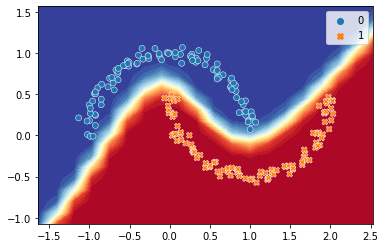

In [ ]:
X, y = make_moons(n_samples=200, noise=0.05) 
classification_dataset = torch.utils.data.TensorDataset(torch.tensor(X, dtype=torch.float32), torch.tensor(y, dtype=torch.long)) 
training_loader = DataLoader(classification_dataset, shuffle=True)

model = nn.Sequential( 
   nn.Linear(2, 30), 
   nn.Tanh(), 
   nn.Linear(30, 30), 
   nn.Tanh(), 
   nn.Linear(30, 50), 
   nn.Tanh(),
   nn.Linear(50, 30), 
   nn.Tanh(),
   nn.Linear(30, 30), 
   nn.Tanh(),
   nn.Linear(30, 2),
)
train_simple_network(model, loss_func, training_loader, epochs=250)

visualize2DSoftmax(X, y, model)

Conclusion: More network layers rock!

# Excercise 6
Try changing the number of neurons used in the hidden layers of the make_moons classification problem. How does it impact performance? 

Epoch:   0%|          | 0/250 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

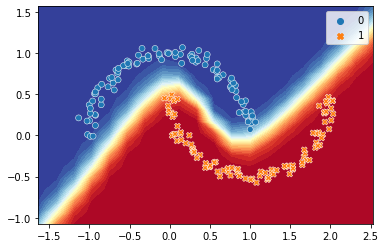

In [ ]:
neurons_number = 400
model = nn.Sequential( 
   nn.Linear(2, neurons_number), 
   nn.Tanh(), 
   nn.Linear(neurons_number, neurons_number), 
   nn.Tanh(), 
   nn.Linear(neurons_number, 2),
)
train_simple_network(model, loss_func, training_loader, epochs=250)

visualize2DSoftmax(X, y, model)

Conclusion: Increasing neurons number in the hidden layer also improves network's performance

# Excercise 7
Use `scikit-learn` to load the breast cancer Wisconsin dataset (https://scikit-learn.org/stable/modules/generated/sklearn.datasets.load_breast_cancer.html), convert it into a TensorDataset, and then split it into 80% for training and 20% for testing. Try to build your own classification neural network for this data. 

In [3]:
from sklearn.datasets import load_breast_cancer
X,y = load_breast_cancer(return_X_y = True)


In [4]:
from torch.utils.data import TensorDataset, random_split

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X, y)

samples_total = X.shape[0]
train_size = int(samples_total * 0.8)
test_size = samples_total - train_size

ds = TensorDataset(torch.tensor(X_scaled, dtype=torch.float32), torch.tensor(y, dtype=torch.long))

r = random_split(ds, [train_size, test_size], generator=torch.Generator().manual_seed(41))
train_dataset = r[0].dataset
test_dataset = r[1].dataset

Epoch:   0%|          | 0/180 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Testing:   0%|          | 0/1 [00:00<?, ?it/s]

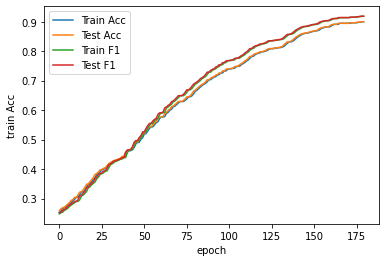

In [5]:
from sklearn.metrics import accuracy_score, f1_score

in_features = X.shape[1]
out_features = 2 
neurons_number = 80
model = nn.Sequential( 
   nn.Linear(in_features, neurons_number), 
   nn.Tanh(), 
   nn.Linear(neurons_number, neurons_number), 
   nn.Tanh(),    
   nn.Linear(neurons_number, out_features),
)

training_loader = DataLoader(train_dataset, batch_size=X.shape[0])
test_loader = DataLoader(test_dataset, batch_size=X.shape[0])

loss_func = nn.CrossEntropyLoss()

score_funcs={'Acc':accuracy_score, 'F1': f1_score}

results_pd = train_simple_network(model, loss_func, training_loader, epochs=180, \
                                       test_loader=test_loader, score_funcs=score_funcs)

sns.lineplot(x='epoch', y='train Acc', data=results_pd, label='Train Acc') 
sns.lineplot(x='epoch', y='test Acc', data=results_pd, label='Test Acc')

# Excercise 8
We saw results on the `make_moons` dataset with a batch size of B = {1, 32, N}. Write a loop to train a new model on that same dataset for every power-of-two batch size less than N (i.e., B = {2, 4, 8, 16, 32, 64, …}, and plot the results. Do you notice any trends in terms of accuracy and/or training time? 

In [19]:
from sklearn.datasets import make_moons 
from sklearn.metrics import accuracy_score, f1_score

def make_moons_batch_size(model, n_samples=300, epochs=80):
  X, y = make_moons(n_samples=n_samples, noise=0.075) 

  score_funcs={'Acc':accuracy_score, 'F1': f1_score}

  loss_func = nn.CrossEntropyLoss()

  classification_dataset = torch.utils.data.TensorDataset(torch.tensor(X, dtype=torch.float32), torch.tensor(y, dtype=torch.long)) 
  batch_pow = 0;
  batch_size = pow(2, batch_pow)

  training_times = []
  accuracies = []

  acc_result = {"batch size" : [], "time" : [], "accuarcy": []}

  while batch_size <= X.shape[0]:
    training_loader = DataLoader(classification_dataset, batch_size=batch_size)

    start_time = time.time()
    results = train_simple_network(model, loss_func, training_loader, epochs=epochs, score_funcs=score_funcs)

    acc_result["batch size"].append(batch_size)
    acc_result["time"].append(time.time() - start_time)
    acc_result["accuarcy"].append(results["train Acc"].iloc[-1])

    batch_pow = batch_pow + 1
    batch_size = pow(2, batch_pow)

  return acc_result

In [20]:
model = nn.Sequential( 
    nn.Linear(2, 100), 
    nn.Tanh(), 
    nn.Linear(100, 100), 
    nn.Tanh(),     
    nn.Linear(100, 2)
  )

acc_result = make_moons_batch_size(model, n_samples=300, epochs=100)

sns.lineplot(x='batch size', y='time', data=acc_result, label='Time')
plt.figure()
sns.lineplot(x='batch size', y='accuarcy', data=acc_result, label='Accuarcy')
plt.figure()
sns.lineplot(x='time', y='accuarcy', data=acc_result, label='Accuarcy')

Epoch:   0%|          | 0/80 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Training:   0%|          | 0/400 [00:00<?, ?it/s]

Epoch:   0%|          | 0/80 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch:   0%|          | 0/80 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/100 [00:00<?, ?it/s]

Epoch:   0%|          | 0/80 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Epoch:   0%|          | 0/80 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch:   0%|          | 0/80 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Training:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch:   0%|          | 0/80 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Training:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch:   0%|          | 0/80 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Training:   0%|          | 0/4 [00:00<?, ?it/s]

Epoch:   0%|          | 0/80 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

Training:   0%|          | 0/2 [00:00<?, ?it/s]

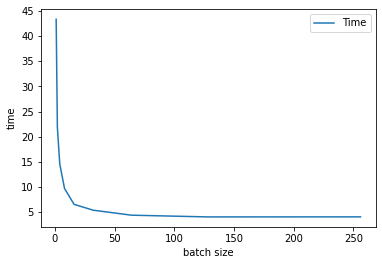

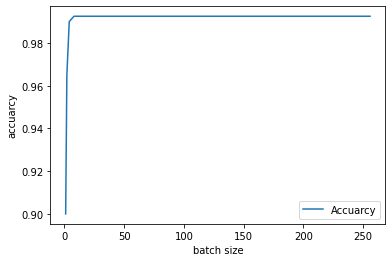

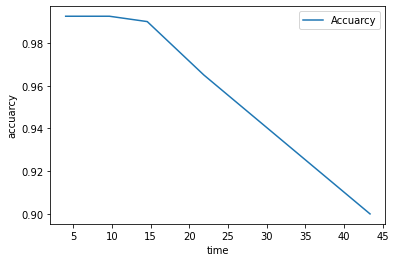

With fixed number of epochs, increase of batch size obviously leads to shorter training time and higher accuracy. What whould be more interesting and practical is to see what accuracy we can reach in a fixed time with different batch sizes.